- numerické řešení teď vrací i u1i
- derivace splinu vrací i koeficienty
- přejmenovat bound na estimate

In [1]:
using DifferentialEquations
using Plots; gr()
using IntervalArithmetic
using DataInterpolations
using LinearAlgebra
using ForwardDiff

In [6]:
"""
Vypočítá numerické řešení p-laplaciánu.

Vstupní parametry:
λi ... interval na kterém hledám λ₁
P ... p z p-laplaciánu
n ... počet kroků dělení

Výstupní hodnoty:
t, ti ... bodové a intervalové dělení časové osy
u1  ... bodové řešení u1
u2, u2i ... intervalové a bodové řešení u2
s ... numerický odhad λ₁
"""
function plaplace_solve(λi, P, n; plt_res=true, u2_0=1.0)
   
    function sl(du,u,p,t) # parametr p je odhad na λ₁ a p z p-laplacianu
        λ, pl = p
        du[1] = abs(u[2])^(1/(pl-1)) * sign(u[2])
        du[2] = -λ * abs(u[1])^(pl-1)*sign(u[1]) 
    end

    u0 = [0.0; u2_0;] # počáteční podmínka
    a, b = λi
    s = (a + b)/2
    Δt = 1.0/(n-1) # velikost intervalu dělení
    e = 1e-12 # zastavovací podmínka

    while (b-a) >= e
        prob = ODEProblem(sl, u0, (0.0, 1.0), (s, P))
        sol = solve(prob, saveat=Δt, abstol=1e-8,reltol=1e-8)
        if sol(1)[1] == 0 # hodnota u₁ v t=1
            break
        else
            probA = ODEProblem(sl, u0, (0.0, 1.0), (a, P))
            solA = solve(probA, saveat=Δt, abstol=1e-8,reltol=1e-8)
            probS = ODEProblem(sl, u0, (0.0, 1.0), (s, P))
            solS = solve(probS, saveat=Δt, abstol=1e-8,reltol=1e-8)
            if solA(1)[1] * solS(1)[1] < 0
                b = s
            else
                a = s
            end
            s = (a+b)/2
        end
    end

    prob = ODEProblem(sl, u0, (0.0, 1.0), (s, P))
    sol = solve(prob, saveat=Δt, abstol=1e-8,reltol=1e-8)

    if plt_res
        println("Numericky získané první vlastní číslo λ₁: $s")
        display(plot(sol,marker=2))
    end
    
    t = sol.t
    ti = [@interval(i) for i in t]
    u1 = [u[1] for u in sol.u]
    u1i = [@interval(u[1]) for u in sol.u]
    u2 = [u[2] for u in sol.u]
    u2i = [@interval(u[2]) for u in sol.u]
    
    return t, ti, u1, u1i, u2, u2i, s
end;

In [3]:
"""
Zadané body proloží intervalově kubickým splinem.

Vstupní parametry:
t, ti         ... bodové a intervalové dělení časové osy
u, ui         ... body a intervaly které prokláme splinem
d2ul, d2ur    ... hodnoty druhé derivace v krajních (levý, pravý) bodech
plt_res=true  ... vykreslení řešení
pn=10         ... dělení jednotlivých oblouů kubického splinu

Výstupní hodnoty:
csc_u ... koeficienty kubického splinu
usi   ... intervalové hodnoty splinu v bodech dělení
"""
function cubic_spline(t, ti, u, ui, d2ul, d2ur; plt_res=true, pn=10)
    #matice A
    n=length(ui)
    dv = [4..4 for i in 1:n-2]
    ev = [1..1 for i in 1:n-3]
    A = Array(SymTridiagonal(dv,ev))
    A_inv = inv(A)

    #pravá strana
    h = 1.0/(n-1)
    rhs = []
    for i in 3:length(ui)
        append!(rhs, 6/h^2 * (ui[i] - 2 * ui[i-1] + ui[i-2]))
    end

    # vektor druhých derivací  
    d2u = []
    append!(d2u, @interval(d2ul))
    append!(d2u, A_inv*rhs)
    append!(d2u, @interval(d2ur))

    # koeficienty jednotlivých oblouků splinu
    csc_u = []
    for i in 1:length(ui)-1
        a=b=c=d=0
        a = (d2u[i+1]-d2u[i])/(6*h)
        b = d2u[i]/2 
        c = (ui[i+1] - ui[i])/h - h*(2*d2u[i]+d2u[i+1])/6
        d = ui[i]
        append!(csc_u, [[a,b,c,d]])
    end 
    

    if plt_res
        p = plot(t, u, marker=2)
    end
    usi = Interval[] # intervalové vyjádření splinu na pi
    for i in 1:length(ui)-1
        x_dom = t[i]..t[i+1]
        x_int = mince(x_dom,pn)
        #f(x) = csc_u[i][1]*(x-ti[i])^3 + csc_u[i][2]*(x-ti[i])^2 + csc_u[i][3]*(x-ti[i]) + csc_u[i][4]
        f(x) = csc_u[i][1]*(x-t[i])^3 + csc_u[i][2]*(x-t[i])^2 + csc_u[i][3]*(x-t[i]) + csc_u[i][4]
        append!(usi, f.(x_int))
        if plt_res
            boxes = IntervalBox.(x_int, f.(x_int))    
            plot!(boxes, legend=false)
        end
    end
    if plt_res display(p) end
        
    return csc_u, usi
end;

In [21]:
"""
Z koeficientů intervalově vypočítá derivaci kubického splinu

Vstupní parametry:
csc           ... intervalové hodnoty splinu v bodech dělení
t, ti         ... bodové i intervalově dělení časové osy
pn            ... počet bodů dělení jednotlivého oblouku splinu
plt_res=true  ... vykreslení řešení


Výstupní hodnoty:
u   ... intervalové hodnoty derivace splinu v bodech dělení

"""
function der_cubic_spline(csc, t, ti, pn; plt_res = true)
    
    u_tmp = Interval[]
    csc_uder = [ [@interval(3) * c[1], @interval(2) * c[2], c[3]] for c in csc ] 
    for i in 1:length(t)-1
        x_dom = t[i]..t[i+1] # domain # range(0,1,length=n)
        x_int = mince(x_dom,pn)
        #f(x) = csc_uder[i][1]*(x-ti[i])^2 + csc_uder[i][2]*(x-ti[i]) + csc_uder[i][3]
        f(x) = csc_uder[i][1]*(x-t[i])^2 + csc_uder[i][2]*(x-t[i]) + csc_uder[i][3]
        append!(u_tmp, f.(x_int))
    end
    
    u = Interval[]
    for i in 1:length(u_tmp)-1
        append!(u, u_tmp[i] ∪ u_tmp[i+1])
    end
    append!(u,u_tmp[end])
    
    if plt_res
        x_int = mince(0..1,length(u))
        display(plot(IntervalBox.(x_int, u), legend=false))
    end
    
    return u
end;

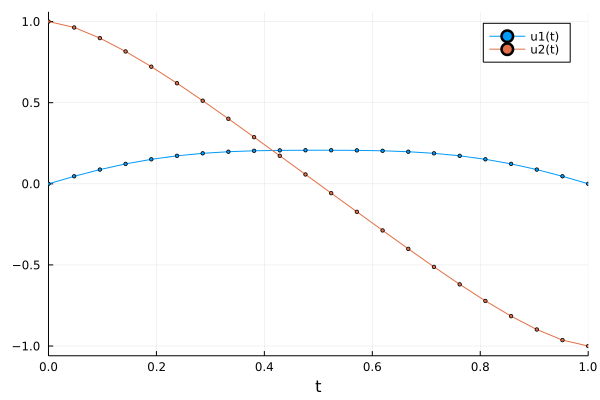

Numericky získané první vlastní číslo λ₁: 5.318718074184005


In [7]:
P=1.5
λ1 = (P-1)*(2*(π/P)/(sin(π/P)))^P

n = 22 # kroků dělení
pn = 1000 # dělení jednotlivého oblouku spline
pi = mince(0..1,(n-1)*pn) # dělení výsledného splinu
λinit = (3.,8.); # interval na kterém hledá λ₁ (nesmí obsahovat i λ₂, jinak to můž najít to)

t, ti, u1, u1i, u2, u2i, l1 = plaplace_solve(λinit, P, n);

In [8]:
#csc_u1, u1si = cubic_spline(t, ti, u1, u1i, -9.988, 10.131, pn=pn);
csc_u1, u1si = cubic_spline(t, ti, u1, u1i, -1, -1, pn=pn);


In [22]:
u1si_der = der_cubic_spline(csc_u1, t, ti, pn);

In [19]:
function upper_estimate(P, u1si, u1si_der)#; plt_res=true)
    
    f(x) = abs(x)^(P)
    ni = mince(0..1,length(u1si))

    numer = 0..0
    for i in 1:length(u1si_der)
        numer = numer + f(u1si_der[i]) * diam(ni[i])
    end
    
    denom = 0..0
    for i in 1:length(u1si)
        denom = denom + f(u1si[i]) * diam(ni[i])
    end

    
    return numer/denom
    
end;

In [20]:
upper_estimate(P, u1si, u1si_der, t, u1)

[5.31665, 5.32082]